In [1]:
import models
from collections import OrderedDict
repo = models.Repository.get(models.Repository.shortname == "ouhsc")

db = models.db

In [2]:
from PIL import Image, ImageDraw
import sys

import pyocr
import pyocr.builders

from IPython.display import display
from IPython.display import Image as IPImage
from IPython.core.display import HTML

tools = pyocr.get_available_tools()
if len(tools) == 0:
    print("No OCR tool found")
    sys.exit(1)
# The tools are returned in the recommended order of usage
tool = tools[0]
print("Will use tool '%s'" % (tool.get_name()))
# Ex: Will use tool 'libtesseract'

langs = tool.get_available_languages()
print("Available languages: %s" % ", ".join(langs))
# lang = langs[0]
# print("Will use lang '%s'" % (lang))
# Ex: Will use lang 'fra'
# Note that languages are NOT sorted in any way. Please refer
# to the system locale settings for the default language
# to use.

Will use tool 'Tesseract (sh)'
Available languages: bel, san, ind, por, chi_tra, eng, rus, est, ceb, bos, yid, srp_latn, lit, aze_cyrl, aze, swe, ita_old, grc, spa, spa_old, asm, urd, slv, tha, lav, khm, tam, uzb, ces, mar, epo, nld, ori, kir, cym, deu_frak, dan, msa, pus, mya, mal, kaz, nep, mlt, swa, vie, fra, lat, afr, deu, jpn, hrv, enm, uig, tir, ell, ara, mkd, pol, sqi, equ, kan, chr, glg, frm, bul, slk, nor, cat, hin, iku, ita, hun, slk_frak, bod, osd, ron, ukr, gle_uncial, dan_frak, syr, tgk, ben, eus, isl, sin, guj, srp, fin, uzb_cyrl, heb, fas, kat, jav, tel, gle, amh, hat, tgl, kur, tur, lao, frk, kor, chi_sim, kat_old, dzo, pan


In [3]:
def boxArea(coords):
    x1 = coords[0][0]
    x2 = coords[1][0]
    y1 = coords[0][1]
    y2 = coords[1][1]
    
    return (x2 - x1) * (y2 - y1)

def charsPerUnitArea( content, position ):
    area = boxArea(position)
    chars = len(content)
    
    return chars/area

In [9]:
query = models.Book.select()

for book in query:
    print(book.full_title + " : " + book.uuid)

"A Description of the Plan of Peking, the Capital of China," Philosophical Transactions of the Royal Society of London, Vol. 50, Part 2 : 641949b1-d13d-5821-b238-ae774c4e078f
"Epistola circa Pythagoricorum, & Copernici opinionem de mobilitate terrae, et stabilitate solis..." in Galileo 1635 Systema cosmicum : 4475e6b4-e08c-541b-9859-e23c9516161a
"Sketch of the Analytical Engine Invented by Charles Babbage by L.F. Menabrea... with Notes," in Scientific Memoirs, vol. 3, pp. 666-731. : 6235e086-c11a-56f6-b50d-1b1f5aaa3f5e
"The Systeme of the World in Four Dialogues" in Thomas Salusbury, Mathematical Discourses, 1661 : b1d3db8e-2865-5acb-88f8-a67dc19d20c2
A Prognostication euerlasting of right good effect...; Lately corrected and augmented by Thomas Digges his sonne : 8a974a11-d382-5b59-a156-b7cc85aef383
A Week's Conversation on the Plurality of Worlds [Entretiens sur la pluralite des mondes] : eb14a997-6891-5fdf-ad81-7a646581e317
Admonitio ad astronomos : 0918f030-2c26-59f4-ba72-ba495545f

In [29]:
keepcharacters = (' ', '.', '_');

chosen_book_uuid = "af6078da-e7f7-5909-b6c9-a03806bcb10f"

query = models.Book.select().where(
#     (models.Page.full_size_downloaded == True) &
    (models.Book.uuid == chosen_book_uuid)
)

files = []

for i, book in enumerate(query):
    meta = eval(book.mods_metadata)
    book_title = "".join( c for c in book.full_title if c.isalnum() or c in keepcharacters ).rstrip()
#     print(meta["mods"]["language"][2])
#     print(meta["mods"]["language"][0]["languageTerm"]["#text"])
    lang = meta["mods"]["language"][0]["languageTerm"]["#text"]
#     lang = meta["mods"]["language"]["languageTerm"]["#text"]
    files_path = "/home/eth/lorisal/lorisal/data/ouhsc/"+ book_title + "/10/"
    print(book_title)
    print(lang)
    for page in book.pages:
        print("-" + str(page.full_size_downloaded))
        if page.full_size_downloaded:
            files.append( files_path + page.uuid + ".jpg" )

China Monumentis
lat
-False
-False
-False
-False
-False
-False
-True
-False
-False
-False
-False
-False
-False
-False
-False
-False
-False
-False
-False
-False
-True
-False
-False
-False
-True
-False
-False
-False
-False
-False
-False
-False
-False
-False
-False
-False
-False
-False
-False
-False
-False
-False
-False
-False
-False
-False
-False
-False
-False
-False
-False
-False
-False
-False
-False
-False
-False
-False
-False
-False
-False
-False
-False
-False
-False
-False
-False
-False
-False
-False
-False
-False
-False
-False
-False
-False
-False
-False
-False
-False
-False
-False
-False
-False
-True
-False
-True
-True
-False
-False
-False
-True
-False
-False
-False
-False
-False
-False
-False
-True
-False
-False
-False
-False
-False
-False
-False
-False
-False
-False
-False
-False
-True
-True
-True
-True
-False
-False
-False
-True
-True
-True
-False
-False
-False
-True
-True
-False
-False
-False
-False
-False
-True
-True
-False
-False
-False
-False
-False
-False
-False
-False
-Fal

In [35]:
print(len(files))
chosen = 50

82


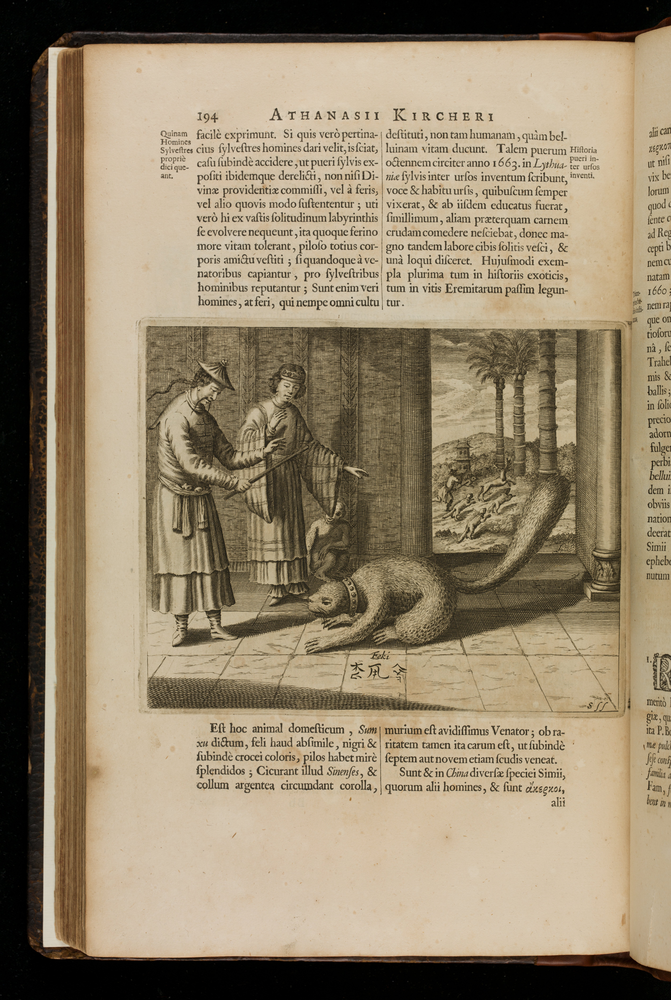

In [36]:
display(IPImage(filename = files[chosen], width=400, height=400))

In [37]:
# lang = 'eng'
# files_path = "/home/eth/lorisal/lorisal/data/ouhsc/Rosa Vrsina/3/"
# file_name = "d929d4a5-c0ae-5b38-9edc-6e3bc7be2649.jpg"

line_and_word_boxes0 = tool.image_to_string(
    Image.open(files[chosen]), lang=lang,
    builder=pyocr.builders.LineBoxBuilder()
)
# list of line objects. For each line object:
#   line.word_boxes is a list of word boxes (the individual words in the line)
#   line.content is the whole text of the line
#   line.position is the position of the whole line on the page (in pixels)
#
# Beware that some OCR tools (Tesseract for instance)
# may return empty boxes

# Digits - Only Tesseract (not 'libtesseract' yet !)
# digits = tool.image_to_string(
    # Image.open('test-digits.png'),
    # lang=lang,
    # builder=pyocr.tesseract.DigitBuilder()
# )
# digits is a python string

In [38]:
len(line_and_word_boxes0)

80

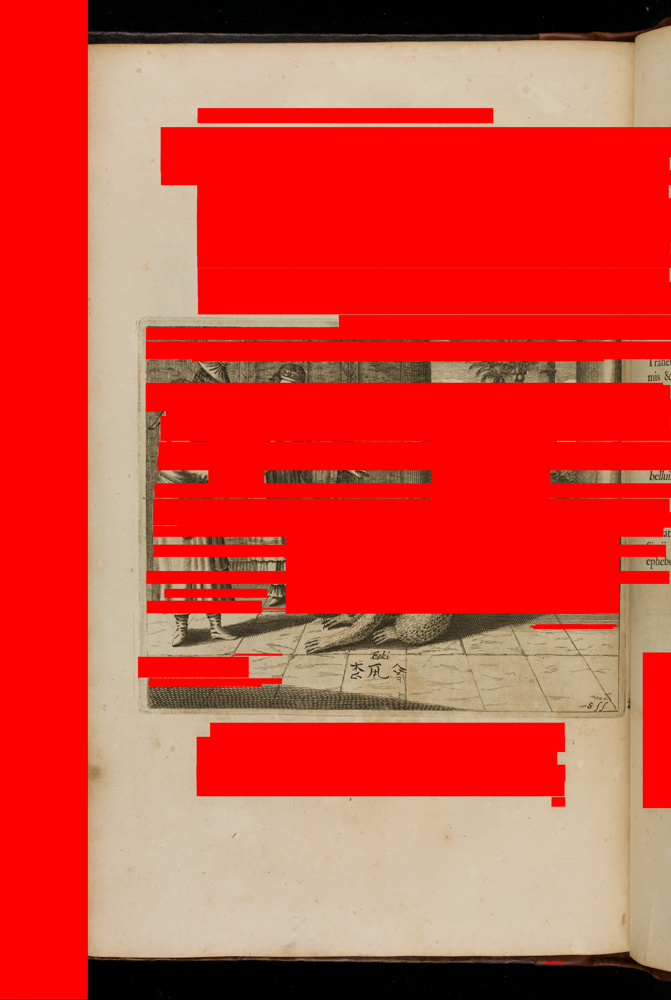

In [42]:
im = Image.open(files[chosen], mode='r')
im = im.convert("RGBA")
bg = Image.new('RGBA', im.size, (255,255,255,0))
recs = ImageDraw.Draw(bg)
draw = ImageDraw.Draw(im)
# a, b, c, d = line_and_word_boxes0[4].position
# print(a)
# print(b)
# print(c)
# print(d)
for i, box in enumerate(line_and_word_boxes0):
    contentAmount = 255 - min(255, int(charsPerUnitArea(box.content, box.position) * 1500 / 255) )
    recs.rectangle(box.position, fill=(255,0,0, contentAmount), outline="rgb(255,0,0)")
#     print( str(i) + ": " + str(contentAmount) )

composite = Image.alpha_composite(im, bg)
# composite = ImageChops.blend(im, bg, 0.5)
    
display(composite)